# 1- Import libraries 

In [21]:
# !pip install xgboost

In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import plotly.express as px 
import seaborn as sns
import warnings 
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.preprocessing import StandardScaler
import missingno as msno
from sklearn.metrics import classification_report,confusion_matrix,precision_score,recall_score
from sklearn.utils import resample
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
# from imblearn.combine import SMOTETomek
# from imblearn.over_sampling import SMOTE
from sklearn.metrics import f1_score
from sklearn.preprocessing import RobustScaler
import xgboost as xgb


## 2- Business understanding 

In [23]:
pd.set_option('display.max_rows', 30)
pd.set_option('display.max_columns', 30)

In [24]:
business_understanding=pd.read_csv('../../Data/columns_description.csv')
business_understanding.head()

,Unnamed: 0,Table,Row,Description,Special
0,1,application_data,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_data,TARGET,Target variable (1 - client with payment diffi...,NaN
2,5,application_data,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_data,CODE_GENDER,Gender of the client,NaN
4,7,application_data,FLAG_OWN_CAR,Flag if the client owns a car,NaN


In [25]:
## knowing all feature meaning
Description_row=business_understanding.loc[:,'Table':'Description']
Description_row.sample(5)

,Table,Row,Description
77,application_data,ELEVATORS_MEDI,Normalized information about building where th...
13,application_data,NAME_EDUCATION_TYPE,Level of highest education the client achieved
129,previous_application.csv,AMT_GOODS_PRICE,Goods price of good that client asked for (if ...
74,application_data,YEARS_BEGINEXPLUATATION_MEDI,Normalized information about building where th...
117,application_data,AMT_REQ_CREDIT_BUREAU_DAY,Number of enquiries to Credit Bureau about the...


## **problem Formulation** 
------------

- **1- Define the Main Objective**

**Example:**

- **Main Objective: Improve loan approval rates and reduce default rates by analyzing the performance of vendors and different industries.**
-------------

**2. Precisely Define the Problem**

**Example:**

- **Determine whether there is a relationship between the performance of vendors and the industries they belong to and the approval and default rates of loans.
  Identify the vendors and industries associated with the highest approval rates and the lowest default rates.**

## 3- EDA 

(Data cleansing and preparation, Insightful visuals)

In [26]:
df=pd.read_csv('../../Data/application_data.csv')
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,...,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,...,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [27]:

shape_data=df.shape
print(f'data consists of {shape_data[0]} row and {shape_data[1]} column')

data consists of 307511 row and 122 column


In [28]:
df_originaL=df.copy()

## 3-1 Data Cleaning 

In [29]:
df_null_percentage = round(df.isnull().sum()*100/len(df),2)
df_null_percentage=df_null_percentage.to_frame().rename(columns={0:'percentage'}).sort_values(by='percentage', ascending=False)
# df_null_percentage=df_null_percentage
df_null_percentage

,percentage
COMMONAREA_MEDI,69.87
COMMONAREA_AVG,69.87
COMMONAREA_MODE,69.87
NONLIVINGAPARTMENTS_MODE,69.43
NONLIVINGAPARTMENTS_AVG,69.43
...,...
NAME_FAMILY_STATUS,0.00
NAME_EDUCATION_TYPE,0.00
NAME_INCOME_TYPE,0.00
AMT_ANNUITY,0.00


In [30]:
## subset columns which contains nulls and sorting it in descending order
df_null=df_null_percentage[df_null_percentage['percentage']>0]
df_null=df_null.sort_values(by='percentage',ascending=False)
df_null

,percentage
COMMONAREA_MEDI,69.87
COMMONAREA_AVG,69.87
COMMONAREA_MODE,69.87
NONLIVINGAPARTMENTS_MODE,69.43
NONLIVINGAPARTMENTS_AVG,69.43
...,...
OBS_30_CNT_SOCIAL_CIRCLE,0.33
OBS_60_CNT_SOCIAL_CIRCLE,0.33
DEF_60_CNT_SOCIAL_CIRCLE,0.33
EXT_SOURCE_2,0.21


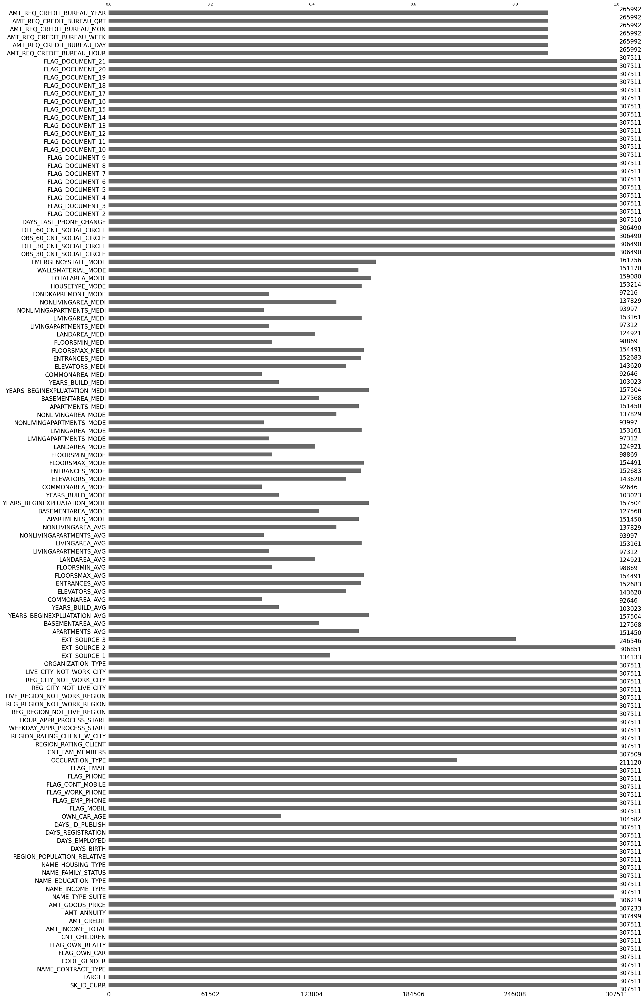

In [31]:
## null_bar
null_bar=msno.bar(df)

In [32]:
## number of columns contains nulls
df_null.shape[0]

64

 i see that most of data which contains nulls contains nulls by percentage 50% to about 70 % so it is being usefull to use them 
 
 DROP columns with high percentage of nulls (columns with percentage) >50%
 
 fill the another column with mean

In [33]:

columns_to_drop=df_null[df_null['percentage']>50]
columns_to_drop=list(columns_to_drop.index)
len(columns_to_drop)

41

get corrleation of missing values more than 50 %

<Axes: >

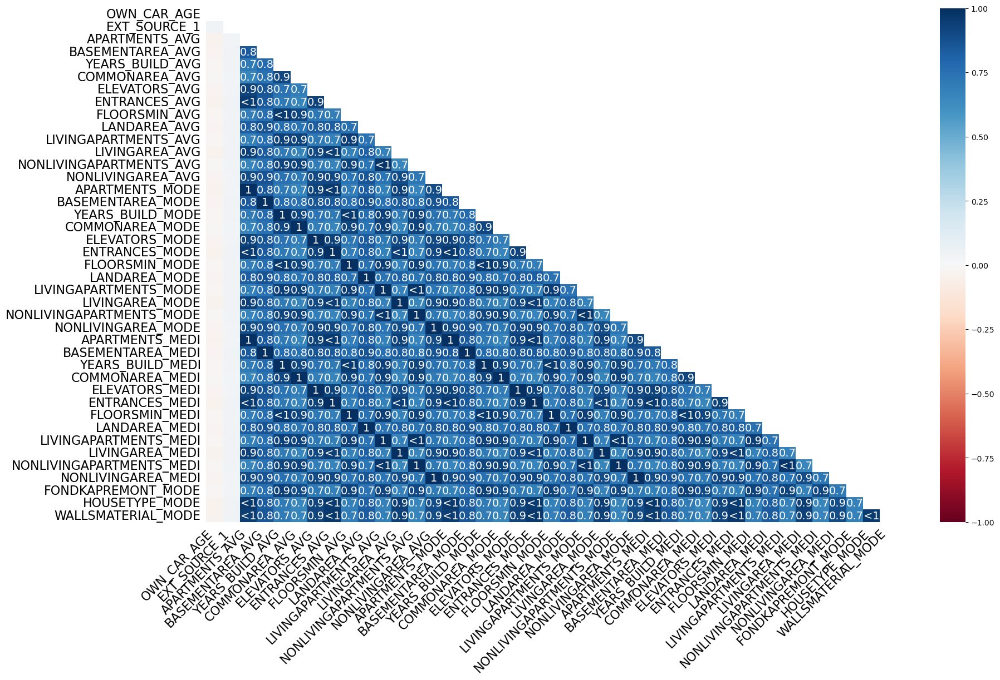

In [35]:
## drop columns with nulls
columns_to_keep = [col for col in df.columns if col  in columns_to_drop]

df1 = df[columns_to_keep]

msno.heatmap(df1)

In [36]:
df1.shape

(307511, 41)

In [37]:
df.isnull().sum()

SK_ID_CURR                        0
TARGET                            0
NAME_CONTRACT_TYPE                0
CODE_GENDER                       0
FLAG_OWN_CAR                      0
                              ...  
AMT_REQ_CREDIT_BUREAU_DAY     41519
AMT_REQ_CREDIT_BUREAU_WEEK    41519
AMT_REQ_CREDIT_BUREAU_MON     41519
AMT_REQ_CREDIT_BUREAU_QRT     41519
AMT_REQ_CREDIT_BUREAU_YEAR    41519
Length: 122, dtype: int64

They have very powerful relations in missing values 


 drop rows with nulls in those columns


In [40]:
df.shape

(307511, 122)

In [42]:
# columns_to_keep = [col for col in df.columns if col not in columns_to_drop]

# df = df[columns_to_keep]

# Drop rows with less than 3 non-null values

df_no_nulls = df[df['AMT_REQ_CREDIT_BUREAU_DAY'].notnull()]

print(df_no_nulls.shape)

(265992, 122)


In [43]:
df.shape

(307511, 122)

In [52]:
## checking for duplicates
df_no_nulls.duplicated(subset=['TARGET'	,'NAME_CONTRACT_TYPE',	'CODE_GENDER',	'FLAG_OWN_CAR',	'FLAG_OWN_REALTY'	,'CNT_CHILDREN',	'AMT_INCOME_TOTAL'	,'AMT_CREDIT',	'AMT_ANNUITY',
                                # 'AMT_GOODS_PRICE',	'NAME_TYPE_SUITE',	'NAME_INCOME_TYPE',	'NAME_EDUCATION_TYPE',	'NAME_FAMILY_STATUS'
                                ]).sum().sum()


52128

we could drop this duplicated 

becaue it isnnot logical to have customers with all similrty in those features

'TARGET'	,'NAME_CONTRACT_TYPE',	'CODE_GENDER',	'FLAG_OWN_CAR',	'FLAG_OWN_REALTY'	,'CNT_CHILDREN',	'AMT_INCOME_TOTAL'	,'AMT_CREDIT',	'AMT_ANNUITY'

In [46]:
df_no_nulls

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,...,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
5,100008,0,Cash loans,M,N,Y,0,99000.0,490495.5,27517.5,454500.0,"Spouse, partner",State servant,Secondary / secondary special,Married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307503,456247,0,Cash loans,F,N,Y,0,112500.0,345510.0,17770.5,247500.0,Unaccompanied,Commercial associate,Higher education,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,2.0
307505,456249,0,Cash loans,F,N,Y,0,112500.0,225000.0,22050.0,225000.0,Unaccompanied,Pensioner,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,2.0,0.0,0.0
307508,456253,0,Cash loans,F,N,Y,0,153000.0,677664.0,29979.0,585000.0,Unaccompanied,Working,Higher education,Separated,...,0,0,0,0,0,0,0,0,0,1.0,0.0,0.0,1.0,0.0,1.0
307509,456254,1,Cash loans,F,N,Y,0,171000.0,370107.0,20205.0,319500.0,Unaccompanied,Commercial associate,Secondary / secondary special,Married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


- **no duplicated**

In [56]:
df_no_nulls_no_duplic = df_no_nulls.drop_duplicates(subset=['TARGET'	,'NAME_CONTRACT_TYPE',	'CODE_GENDER',	'FLAG_OWN_CAR',	'FLAG_OWN_REALTY'	,'CNT_CHILDREN',	'AMT_INCOME_TOTAL'	,'AMT_CREDIT',	'AMT_ANNUITY',],)
df_no_nulls.shape[0],df_no_nulls_no_duplic.shape[0]

(265992, 213864)

## 3-2 EDA Analysis

In [57]:
df_no_nulls_no_duplic.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,...,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
5,100008,0,Cash loans,M,N,Y,0,99000.0,490495.5,27517.5,454500.0,"Spouse, partner",State servant,Secondary / secondary special,Married,...,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,1.0


First we want to know number of clients Those who defaulted on the loan 

In [58]:
df = df_no_nulls_no_duplic.copy()

In [64]:
round(df['TARGET'].value_counts(normalize=True)*100)

TARGET
0    91.0
1     9.0
Name: proportion, dtype: float64

In [22]:
## visualization by funnel to clarify percentage

In [66]:
TARGET=df['TARGET'].value_counts()
TARGET=TARGET.to_frame()
TARGET=TARGET.reset_index()
# TARGET=TARGET.rename(columns={'index':'statue'})
# TARGET=TARGET.set_index('statue')
TARGET

,TARGET,count
0,0,194578
1,1,19286


In [67]:
fig=px.funnel(TARGET,color_discrete_sequence=['red'])
fig.update_layout(title='showing the count of status in paying loans'
)

- **As we see 19,286 k don't pay the loans**

- **194578 pay the loans**

# Visuals - **Bussiness Question** 

## What are the reasons for defaulting on the loan?

**Distribution of Target Variable**
------------------------------------------



**What is the proportion of clients who defaulted on their loans versus those who did not?** **[answerd]**

**Demographic Factors:**
-------------------------------------
**How does age influence loan default rates?**

**Are there differences in default rates based on gender?**

**How does marital status affect the likelihood of default?**

**Employment and Income:**
------------------------------------------------
**What is the relationship between employment type and loan default rates?
How does income level correlate with the likelihood of default?
Is there a difference in default rates among different industries or job roles?
Credit History:**

**How does the length of credit history affect the probability of default?
What is the impact of previous defaults on current loan default rates?
How does the number of credit lines or loans a client has influence their default rate?
Loan Characteristics:**

**What types of loans have higher default rates?
How do interest rates correlate with default rates?
Is there a relationship between loan amount and the likelihood of default?
Financial Behavior:**

**How does the debt-to-income ratio affect default rates?
What is the impact of credit card usage and balance on loan defaults?
How does the presence of other debts or loans influence default risk?
External Economic Factors:**

**How do macroeconomic factors like unemployment rate and inflation correlate with loan default rates?
Are there seasonal trends or specific time periods with higher default rates?
Additional Factors:**

**How does the geographic location of the client affect default rates?
What is the role of education level in loan defaults?
Are there any patterns or correlations with family size or number of dependents?**

## How does age influence loan default rates

## FEATURE ENGINEERING

### Age

In [68]:
## number of days since the client is born
df['DAYS_BIRTH'].head()


0    -9461
1   -16765
2   -19046
4   -19932
5   -16941
Name: DAYS_BIRTH, dtype: int64

In [69]:
## we can calculate age
df['age_year']=df['DAYS_BIRTH']/-365
## to extract the exact number
df['age_year']=df['age_year'].astype('int')
df['age_year'].head()

0    25
1    45
2    52
4    54
5    46
Name: age_year, dtype: int32

<Axes: xlabel='age_year', ylabel='Density'>

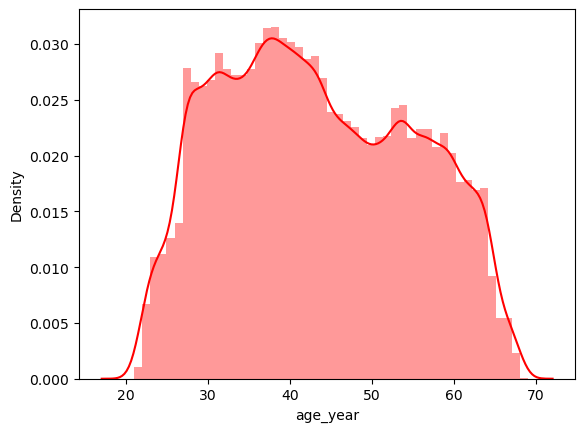

In [70]:
## first : i want to see the disturbution of ages 
sns.distplot(df['age_year'],color='red')

In [71]:
## knowing age range
min_age=df['age_year'].min()
max_age=df['age_year'].max()

In [72]:
print(f'AGE ranges from {min_age} to {max_age}')

AGE ranges from 20 to 69


In [73]:
## showing the majority of data 
px.box(df['age_year'])

The majority from 34 to 53


Categorizing and Binning

In [74]:
## divide age into categories 
age_bins = [20, 29, 39, 49, 59, 69]
age_labels = ['20-29', '30-39', '40-49', '50-59', '60-69']
df['AGE_CATEGORY'] = pd.cut(df['age_year'], bins=age_bins, labels=age_labels, right=False)
df['AGE_CATEGORY'].head()

0    20-29
1    40-49
2    50-59
4    50-59
5    40-49
Name: AGE_CATEGORY, dtype: category
Categories (5, object): ['20-29' < '30-39' < '40-49' < '50-59' < '60-69']

In [80]:
## count of Age category which apply to loan 
count_AGE_category_on_data=df['AGE_CATEGORY'].value_counts()
count_AGE_category_on_data=count_AGE_category_on_data.to_frame()
count_AGE_category_on_data=count_AGE_category_on_data.reset_index()
count_AGE_category_on_data

,AGE_CATEGORY,count
0,30-39,59780
1,40-49,56243
2,50-59,46492
3,60-69,28101
4,20-29,23239


**i will remind you by the information that the top people who apply for loans are in age between 34 and 53**
**AGE_CATEGORY 30-39 is the most category of people who apply for loans**

In [81]:

## age category count of applying for loans
px.pie(
    count_AGE_category_on_data,names='AGE_CATEGORY',
    values='count',
    color_discrete_sequence=['green','blue','orange','red','yellow'],
  
)

In [82]:
## Age category _ which _defaulted_on_loans
defaulted_on_loans=df[df['TARGET']==1]
age_category_Who_defaulted_on_loans=defaulted_on_loans.groupby('AGE_CATEGORY')['TARGET'].agg('count')
age_category_Who_defaulted_on_loans=age_category_Who_defaulted_on_loans.to_frame()
age_category_Who_defaulted_on_loans=age_category_Who_defaulted_on_loans.sort_values(by='TARGET',ascending=False)
age_category_Who_defaulted_on_loans=age_category_Who_defaulted_on_loans.reset_index()
age_category_Who_defaulted_on_loans

,AGE_CATEGORY,TARGET
0,30-39,6373
1,40-49,4902
2,50-59,3364
3,20-29,2959
4,60-69,1688


In [83]:
## the most percentage category which defaulted_on_loans 
data_Category_percentage=count_AGE_category_on_data.merge(age_category_Who_defaulted_on_loans,on='AGE_CATEGORY')
data_Category_percentage=data_Category_percentage.rename(columns={'count':'All_Count','TARGET':'count_defaulted_on_loans'})
data_Category_percentage

,AGE_CATEGORY,All_Count,count_defaulted_on_loans
0,30-39,59780,6373
1,40-49,56243,4902
2,50-59,46492,3364
3,60-69,28101,1688
4,20-29,23239,2959


In [84]:
## extract percentage
data_Category_percentage['percentage_on_defaulted_on_loans']=data_Category_percentage['count_defaulted_on_loans']/data_Category_percentage['All_Count']
data_Category_percentage=data_Category_percentage.sort_values(by='percentage_on_defaulted_on_loans',ascending=False)
data_Category_percentage

,AGE_CATEGORY,All_Count,count_defaulted_on_loans,percentage_on_defaulted_on_loans
4,20-29,23239,2959,0.127329
0,30-39,59780,6373,0.106608
1,40-49,56243,4902,0.087158
2,50-59,46492,3364,0.072357
3,60-69,28101,1688,0.060069


- **Top percentage in Age Category which defaulted_on_loans are 20-29**

- **there are the less count of applying on loan**

In [85]:
fig=px.line(data_Category_percentage,x='AGE_CATEGORY',y='percentage_on_defaulted_on_loans',color_discrete_sequence=['red'])
fig.update_layout(title='percentage_on_defaulted_on_loans by Age Category'
)

### Gender Disturbution 

In [86]:
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,...,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,age_year,AGE_CATEGORY
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,25,20-29
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,...,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,45,40-49
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,52,50-59
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,...,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,54,50-59
5,100008,0,Cash loans,M,N,Y,0,99000.0,490495.5,27517.5,454500.0,"Spouse, partner",State servant,Secondary / secondary special,Married,...,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,1.0,46,40-49


In [89]:
## Gender_count
Gender_count=df['CODE_GENDER'].value_counts()
Gender_count=Gender_count.to_frame()
Gender_count=Gender_count.reset_index()
# Gender_count=Gender_count.rename(columns={'index':'Gender','CODE_GENDER':'count'})
Gender_count

,CODE_GENDER,count
0,F,137304
1,M,76556
2,XNA,4


In [90]:
fig=px.histogram(Gender_count,x='CODE_GENDER',y='count',color_discrete_sequence=['red'])
fig.update_layout(title='Gender count (All)',
                  xaxis_title='gender',
                  yaxis_title='count'
)

**we can conclude that Females are the most gender type which apply for loans then male then XNA**

**XNA is that who dont specify his gender** 


In [91]:
## knowing the count of female and male and xna who defaulated on loans 
gender_defaulted_on_loans=defaulted_on_loans.groupby('CODE_GENDER')['TARGET'].agg('count')
gender_defaulted_on_loans=gender_defaulted_on_loans.to_frame()
gender_defaulted_on_loans=gender_defaulted_on_loans.reset_index()
gender_defaulted_on_loans=gender_defaulted_on_loans.rename(columns={'CODE_GENDER':'Gender','TARGET':'count gender_defaulted_on_loans'})
gender_defaulted_on_loans

,Gender,count gender_defaulted_on_loans
0,F,11101
1,M,8185


**the number if male and female which defaulted_on_loans is mentioned above**

**i dont see XNA as all xna paid the loans and dont defaulted_on_loans**

In [92]:
## scatter plot to explain the count
fig=px.scatter(gender_defaulted_on_loans,x='Gender',y='count gender_defaulted_on_loans',size='count gender_defaulted_on_loans',color_discrete_sequence=['red'])
fig.update_layout(xaxis_title='Gender',
                  yaxis_title='count',
                  title='Gender count who defaulted_on_loans'
)


- **we confirmed that**
------------------------------
- **Female is the most gender type which defaulted_on_loans but not the most percentage we should check percentage as the number of female count in all (paying or defaulting ) is greater than male**
- **all XNA (Gender_type) pays loans and dont have defaulted_on_loans (dont appear in figure)**

In [96]:
gender_defaulted_on_loans

,Gender,count gender_defaulted_on_loans
0,F,11101
1,M,8185


In [97]:
## percentage on defaulted_on_loans by Gender 
percentage_on_defaulted_on_loans_by_Gender=Gender_count.merge(gender_defaulted_on_loans,left_on='CODE_GENDER',
right_on='Gender')
percentage_on_defaulted_on_loans_by_Gender

,CODE_GENDER,count,Gender,count gender_defaulted_on_loans
0,F,137304,F,11101
1,M,76556,M,8185


In [98]:
## specify percentage 
percentage_on_defaulted_on_loans_by_Gender['percentage']=percentage_on_defaulted_on_loans_by_Gender['count gender_defaulted_on_loans']/percentage_on_defaulted_on_loans_by_Gender['count']
percentage_on_defaulted_on_loans_by_Gender=percentage_on_defaulted_on_loans_by_Gender.sort_values(by='percentage',ascending=False)
percentage_on_defaulted_on_loans_by_Gender

,CODE_GENDER,count,Gender,count gender_defaulted_on_loans,percentage
1,M,76556,M,8185,0.106915
0,F,137304,F,11101,0.080850


- **the percentage of male is greater than female**

<Axes: xlabel='Gender', ylabel='percentage'>

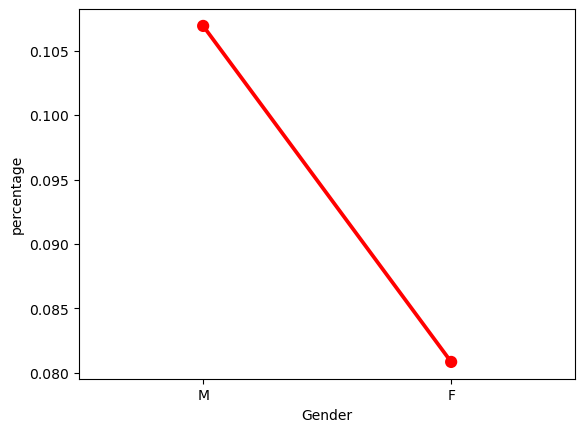

In [99]:
sns.pointplot(percentage_on_defaulted_on_loans_by_Gender,x='Gender',y='percentage',color='red')

### Education Type

In [105]:
## knowing the most Education type which apply to loans
Education_Type =df['NAME_EDUCATION_TYPE'].value_counts()
Education_Type=Education_Type.to_frame().reset_index()
Education_Type=Education_Type.rename(columns={'NAME_EDUCATION_TYPE':'Education_type'})
Education_Type

,Education_type,count
0,Secondary / secondary special,150212
1,Higher education,54007
2,Incomplete higher,6940
3,Lower secondary,2587
4,Academic degree,118


- **Secondary / secondary special	is most people who apply for loan**
- **Academic degree is the least people who apply for loan**

In [106]:
## count_of_defaulted_on_loans by Education_Type
count_of_defaulted_on_loans_by_Education_Type=defaulted_on_loans.groupby('NAME_EDUCATION_TYPE')['TARGET'].agg('count')
count_of_defaulted_on_loans_by_Education_Type=count_of_defaulted_on_loans_by_Education_Type.to_frame()
count_of_defaulted_on_loans_by_Education_Type=count_of_defaulted_on_loans_by_Education_Type.reset_index()
count_of_defaulted_on_loans_by_Education_Type=count_of_defaulted_on_loans_by_Education_Type.sort_values(by='TARGET',ascending=False)
count_of_defaulted_on_loans_by_Education_Type=count_of_defaulted_on_loans_by_Education_Type.rename(columns={'NAME_EDUCATION_TYPE':'Education_type'})
count_of_defaulted_on_loans_by_Education_Type

,Education_type,TARGET
4,Secondary / secondary special,15028
1,Higher education,3297
2,Incomplete higher,645
3,Lower secondary,313
0,Academic degree,3


- **Secondary / secondary special	is most people who defaulted_on_loans**
- **Academic degree is the least people who defaulted_on_loans**

In [107]:
Education_Type

,Education_type,count
0,Secondary / secondary special,150212
1,Higher education,54007
2,Incomplete higher,6940
3,Lower secondary,2587
4,Academic degree,118


In [108]:
education_percentage=Education_Type.merge(count_of_defaulted_on_loans_by_Education_Type,on='Education_type')

In [109]:
education_percentage['percentage']=education_percentage['TARGET']/education_percentage['count']
education_percentage=education_percentage.sort_values(by='percentage',ascending=False)
education_percentage

,Education_type,count,TARGET,percentage
3,Lower secondary,2587,313,0.120990
0,Secondary / secondary special,150212,15028,0.100045
2,Incomplete higher,6940,645,0.092939
1,Higher education,54007,3297,0.061048
4,Academic degree,118,3,0.025424


In [110]:
fig=px.bar(education_percentage,x='Education_type',y='percentage',color='Education_type')
fig.update_layout(title='the percentage of Education type which defaulted_on_loans'
)

## income 

In [111]:
## INCOME DISTURBUTION
px.box(df['AMT_INCOME_TOTAL'])

In [112]:
q1=df['AMT_INCOME_TOTAL'].quantile(0.25)
q3=df['AMT_INCOME_TOTAL'].quantile(0.75)
print(f'income Stationed in from {q1} to {q3}')

income Stationed in from 112500.0 to 220500.0


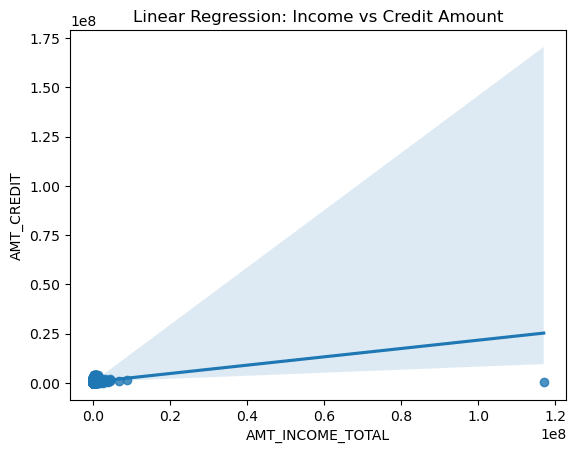

In [113]:
## is there relation between amount of income of clieant and total and AMT_CREDIT and paying the loan
sns.regplot(x='AMT_INCOME_TOTAL', y='AMT_CREDIT', data=df)
plt.title('Linear Regression: Income vs Credit Amount')
plt.show()

**as we see if Income increase Credit Amount also increase thats mean people the if your pay is high the chance of approval of loan increase**

In [114]:
## Therefore, data_pct will contain the NAME_CONTRACT_TYPE groups sorted by the percentage of TARGET (mean of TARGET values), with the percentage values stored in the PCT column. This process helps in understanding the distribution or prevalence of the TARGET across different categories of NAME_CONTRACT_TYPE
data_pct = df[['NAME_CONTRACT_TYPE','TARGET']].groupby(['NAME_CONTRACT_TYPE'], as_index=False).mean().sort_values(by='TARGET',ascending=False)


data_pct['PCT'] = data_pct['TARGET']*100

cash loans and  revoloving loans and relation with target

<Axes: xlabel='NAME_CONTRACT_TYPE', ylabel='PCT'>

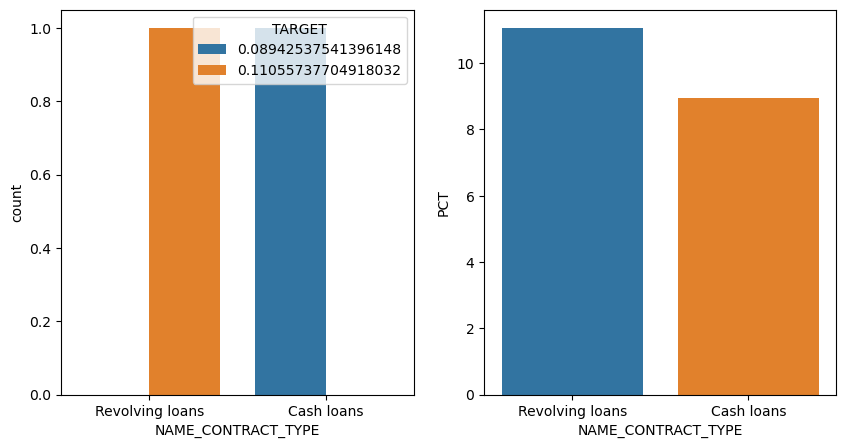

In [115]:
plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
sns.countplot(data=data_pct,x='NAME_CONTRACT_TYPE',hue='TARGET')

plt.subplot(1,2,2)
sns.barplot(data=data_pct,x='NAME_CONTRACT_TYPE',y='PCT')

**the majority of people which demond cash loans dont pay the loan**

# 4- PReprocessing for Modeling

In [116]:
numeric_df=df.select_dtypes(include=[int, float])

In [117]:
X = numeric_df.loc[:, numeric_df.columns != 'TARGET']

In [118]:
y=df['TARGET']
y.head()

0    1
1    0
2    0
4    0
5    0
Name: TARGET, dtype: int64

In [57]:
## checking for imbalned data 

In [119]:
target_count=df['TARGET'].value_counts()
target_count

TARGET
0    194578
1     19286
Name: count, dtype: int64

In [120]:
fig=px.pie(target_count,names=target_count.index,values=target_count.values,color_discrete_sequence=['blue','red'])
fig.update_layout(title='The count of 0 and 1 on Target column'
)

**- As we see there imbalanced data**

## Treating imbalanced data

In [121]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42,stratify=y)

In [ ]:
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

In [62]:
y_resampled.value_counts()

0    226148
1    226148
Name: TARGET, dtype: int64

In [63]:
## now balanced data is treated

In [64]:
clf_before_process = RandomForestClassifier(random_state=42)
clf_before_process

RandomForestClassifier(random_state=42)

In [65]:
clf_before_process.fit(X_resampled,y_resampled)

RandomForestClassifier(random_state=42)

In [66]:
y_pred_b=clf_before_process.predict(X_test)

In [67]:
accuracy=accuracy_score(y_test,y_pred_b)
accuracy

0.8614376534477993

In [68]:
report = classification_report(y_test, y_pred_b)
print(report)

              precision    recall  f1-score   support

           0       0.92      0.93      0.92     56538
           1       0.11      0.10      0.11      4965

    accuracy                           0.86     61503
   macro avg       0.52      0.52      0.52     61503
weighted avg       0.86      0.86      0.86     61503



In [69]:
print("Random Forest Metrics:")
print("Accuracy:", accuracy_score(y_test, y_pred_b))
print("Precision:", precision_score(y_test, y_pred_b))
print("Recall:", recall_score(y_test, y_pred_b))
print("F1 Score:", f1_score(y_test, y_pred_b))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_b))

Random Forest Metrics:
Accuracy: 0.8614376534477993
Precision: 0.11278031787502721
Recall: 0.10433031218529708
F1 Score: 0.10839087675245868
Confusion Matrix:
 [[52463  4075]
 [ 4447   518]]


#### Class 0:
- **Precision**: 0.92
  - Of all the samples predicted as class 0, 92% were correctly predicted (true positives out of all predicted positives).
- **Recall**: 0.93
  - Of all the actual samples of class 0, 93% were correctly identified (true positives out of all actual positives).
- **F1-Score**: 0.93
  - The harmonic mean of precision and recall for class 0, indicating a balance between the two metrics.
- **Support**: 56,554
  - The number of actual instances of class 0 in the dataset.

#### Class 1:
- **Precision**: 0.11
  - Of all the samples predicted as class 1, only 11% were correctly predicted (true positives out of all predicted positives).
- **Recall**: 0.10
  - Of all the actual samples of class 1, only 10% were correctly identified (true positives out of all actual positives).
- **F1-Score**: 0.11
  - The harmonic mean of precision and recall for class 1, indicating a balance between the two metrics.
- **Support**: 4,949
  - The number of actual instances of class 1 in the dataset.

#### Overall Model Performance:
- **Accuracy**: 0.86
  - The overall accuracy of the model, which is the proportion of correctly classified instances (both class 0 and class 1) out of the total instances in the dataset.
- **Macro avg**:
  - **Precision**: 0.52
    - The unweighted average precision across both classes (0 and 1).
  - **Recall**: 0.52
    - The unweighted average recall across both classes.
  - **F1-Score**: 0.52
    - The unweighted average F1-Score across both classes.
- **Weighted avg**:
  - **Precision**: 0.86
    - The weighted average precision, considering the support (number of instances) for each class.
  - **Recall**: 0.86
    - The weighted average recall.
  - **F1-Score**: 0.86
    - The weighted average F1-Score.

This Markdown structure provides a clear and organized representation of the classification metrics and their explanations for both classes, as well as overall performance metrics. It should display neatly in your Jupyter Notebook environment.

## confusion matrix

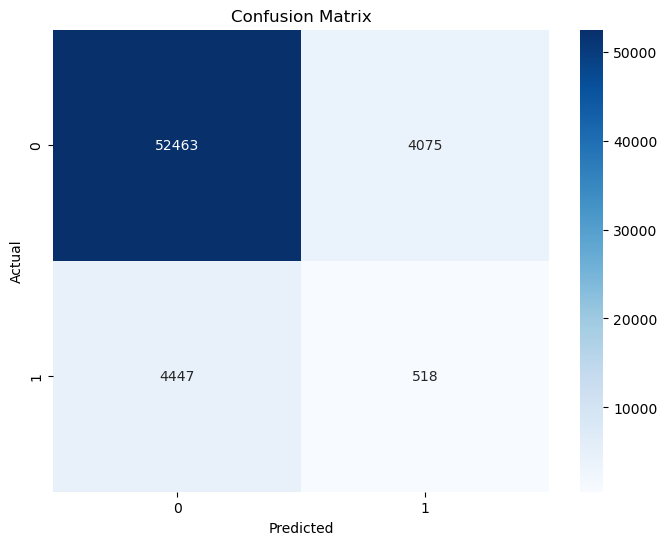

In [70]:
conf_matrix_R = confusion_matrix(y_test, y_pred_b)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_R, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

 - **True Positives (TP): 52,547 - The model correctly predicted 52,547 instances as class 0.**
 - **False Positives (FP): 4,007 - The model incorrectly predicted 4,007 instances as class 0 that were actually class 1.**
  - **True Negatives (TN): 516 - The model correctly predicted 516 instances as class 1.**
  - **False Negatives (FN): 4,433 - The model incorrectly predicted 4,433 instances as class 1 that were actually class 0.**

In [71]:
## After processing 

## Treat outliers 

In [174]:
## knowing if there outliers 

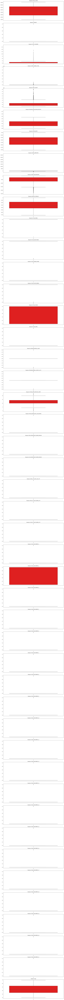

In [73]:
num_features = len(numeric_df.columns)

plt.figure(figsize=(15, num_features * 5))


for i, column in enumerate(numeric_df.columns, 1):
    plt.subplot(num_features, 1, i)  
    sns.boxplot(data=numeric_df[column],color='red')
    plt.title(f'Boxplot of {column}')

plt.tight_layout()

plt.show()

In [74]:
## the majority of columns contains outliers so i treat the outliers

In [75]:
def treat_outliers(dataFrame,x):
    Q1=dataFrame[x].quantile(0.25)
    Q3=dataFrame[x].quantile(0.75)
    IQR=Q3-Q1
    lower_Bound=Q3-1.5*IQR
    upper_Bound=Q3+1.5*IQR
    z=dataFrame[x].clip(lower_Bound,upper_Bound)
    return z


In [76]:
for i in numeric_df.columns:
    numeric_df[i]=treat_outliers(numeric_df,i)

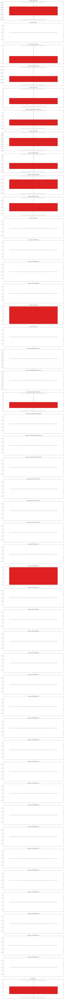

In [77]:
num_features = len(numeric_df.columns)

plt.figure(figsize=(15, num_features * 5))


for i, column in enumerate(numeric_df.columns, 1):
    plt.subplot(num_features, 1, i)  
    sns.boxplot(data=numeric_df[column],color='red')
    plt.title(f'Boxplot of {column}')

plt.tight_layout()

plt.show()

In [78]:
## outliers is done 


## Scaling 

In [79]:
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)

X_test_scaled = scaler.transform(X_test)


In [80]:
smote_after= SMOTE(random_state=42,class_weight='balanced')
X_resampled_after, y_resampled_after = smote_after.fit_resample(X_train_scaled, y_train)

## Feature Selection by Select k_best 

In [175]:
selector = SelectKBest(f_classif, k=50)
X_train_selected = selector.fit_transform(X_resampled_after, y_resampled_after)
X_test_selected = selector.transform(X_test_scaled)
selected_features = X.columns[selector.get_support()]
selected_features

Index(['DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
       'FLAG_EMP_PHONE', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'REG_CITY_NOT_WORK_CITY', 'FLAG_DOCUMENT_3', 'age'],
      dtype='object')

## Random Forest

In [87]:
clf_random_A = RandomForestClassifier(n_estimators=100,random_state=42)

In [88]:
clf_random_A.fit(X_train_selected, y_resampled_after)


RandomForestClassifier(random_state=42)

In [89]:
y_pred_clf = clf_random_A.predict(X_test_selected)

In [90]:
accuracy_random_clf = accuracy_score(y_test, y_pred_clf)
accuracy_random_clf

0.8769165731752923

In [91]:
report_clf = classification_report(y_test, y_pred_clf)

print("Classification Report:\n", report_clf)

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.95      0.93     56538
           1       0.13      0.09      0.11      4965

    accuracy                           0.88     61503
   macro avg       0.53      0.52      0.52     61503
weighted avg       0.86      0.88      0.87     61503



#### Class 0:
- **Precision:** 0.92
  - Of all instances predicted as class 0, 92% were correctly predicted (true positives out of all predicted positives).
- **Recall:** 0.95
  - Of all actual instances of class 0, 95% were correctly identified (true positives out of all actual positives).
- **F1-Score:** 0.93
  - The harmonic mean of precision and recall, indicating a balance between the two metrics.
- **Support:** 56,538
  - The number of actual instances of class 0 in the dataset.

#### Class 1:
- **Precision:** 0.13
  - Of all instances predicted as class 1, only 13% were correctly predicted (true positives out of all predicted positives).
- **Recall:** 0.09
  - Of all actual instances of class 1, only 9% were correctly identified (true positives out of all actual positives).
- **F1-Score:** 0.11
  - The harmonic mean of precision and recall, reflecting how well the model predicts class 1.
- **Support:** 4,965
  - The number of actual instances of class 1 in the dataset.

#### Overall Metrics:
- **Accuracy:** 0.88
  - The overall percentage of correctly predicted instances (both classes) out of the total instances in the dataset.
- **Macro Avg:**
  - **Precision:** 0.53, **Recall:** 0.52, **F1-Score:** 0.52
  - The average precision, recall, and F1-score across both classes.
- **Weighted Avg:**
  - **Precision:** 0.86, **Recall:** 0.88, **F1-Score:** 0.87
  - The weighted average precision, recall, and F1-score, accounting for the imbalance in class support.

In [177]:
print("Random Forest Metrics:")
print("Accuracy:", accuracy_score(y_test, y_pred_clf))
print("Precision:", precision_score(y_test, y_pred_clf))
print("Recall:", recall_score(y_test, y_pred_clf))
print("F1 Score:", f1_score(y_test, y_pred_clf))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_clf))

Random Forest Metrics:
Accuracy: 0.8769165731752923
Precision: 0.1279634390174236
Recall: 0.09023162134944612
F1 Score: 0.10583510512638791
Confusion Matrix:
 [[53485  3053]
 [ 4517   448]]


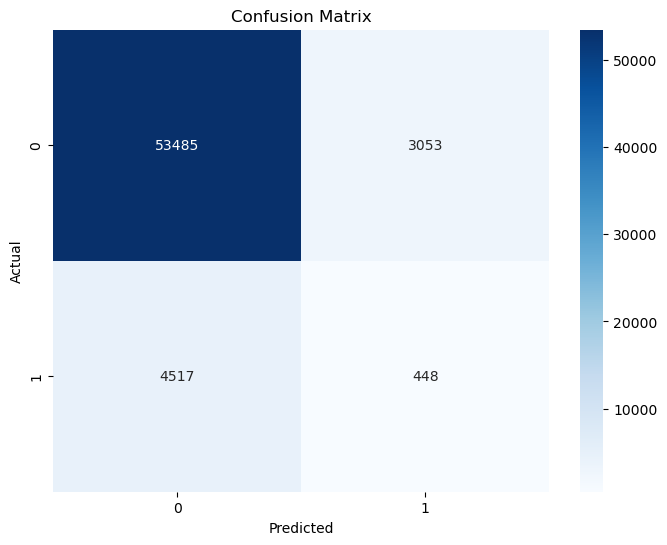

In [178]:
## representing by heatmap 
conf_matrix_R = confusion_matrix(y_test, y_pred_clf)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_R, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

---------------------------------------------

## Applying Robust Scaler

In [179]:
## Robust scaler on random forest
scaler = RobustScaler()
X_train_scaled_R = scaler.fit_transform(X_train)
X_test_scaled_R = scaler.transform(X_test)

In [180]:
smote_after_r= SMOTE(random_state=42)
X_resampled_after_r, y_resampled_after_r = smote_after_r.fit_resample(X_train_scaled_R, y_train)

In [181]:
selector = SelectKBest(f_classif, k=10)
X_train_selected = selector.fit_transform(X_resampled_after_r, y_resampled_after_r)
X_test_selected = selector.transform(X_test_scaled_R)
selected_features_r = X.columns[selector.get_support()]
selected_features_r

Index(['DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
       'FLAG_EMP_PHONE', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'REG_CITY_NOT_WORK_CITY', 'FLAG_DOCUMENT_3', 'age'],
      dtype='object')

In [101]:
clf_random_r = RandomForestClassifier(n_estimators=100,random_state=42,class_weight='balanced')

In [102]:
clf_random_r.fit(X_train_selected, y_resampled_after_r)


RandomForestClassifier(class_weight='balanced', random_state=42)

In [103]:
y_pred_clf_r = clf_random_r.predict(X_test_selected)

In [104]:
accuracy_random_clf_r = accuracy_score(y_test, y_pred_clf_r)
accuracy_random_clf_r

0.8787864006633823

In [145]:
report_clf = classification_report(y_test, y_pred_clf_r)

print("Classification Report:\n", report_clf)

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.95      0.93     56538
           1       0.14      0.10      0.11      4965

    accuracy                           0.88     61503
   macro avg       0.53      0.52      0.52     61503
weighted avg       0.86      0.88      0.87     61503



#### Class 0:
- **Precision:** 0.92
  - Out of all instances predicted as class 0, 92% were correctly predicted (true positives out of all predicted positives).
- **Recall:** 0.95
  - Of all actual instances of class 0, 95% were correctly identified (true positives out of all actual positives).
- **F1-Score:** 0.93
  - The harmonic mean of precision and recall, indicating a balance between the two metrics.
- **Support:** 56,538
  - The number of actual instances of class 0 in the dataset.

#### Class 1:
- **Precision:** 0.14
  - Of all instances predicted as class 1, only 14% were correctly predicted (true positives out of all predicted positives).
- **Recall:** 0.10
  - Of all actual instances of class 1, only 10% were correctly identified (true positives out of all actual positives).
- **F1-Score:** 0.11
  - The harmonic mean of precision and recall, reflecting how well the model predicts class 1.
- **Support:** 4,965
  - The number of actual instances of class 1 in the dataset.

#### Overall Metrics:
- **Accuracy:** 0.88
  - The overall percentage of correctly predicted instances (both classes) out of the total instances in the dataset.
- **Macro Avg:**
  - **Precision:** 0.53, **Recall:** 0.52, **F1-Score:** 0.52
  - The average precision, recall, and F1-score across both classes.
- **Weighted Avg:**
  - **Precision:** 0.86, **Recall:** 0.88, **F1-Score:** 0.87
  - The weighted average precision, recall, and F1-score, accounting for the imbalance in class support.

In [106]:
print("Random Forest Metrics:")
print("Accuracy:", accuracy_score(y_test, y_pred_clf_r))
print("Precision:", precision_score(y_test, y_pred_clf_r))
print("Recall:", recall_score(y_test, y_pred_clf_r))
print("F1 Score:", f1_score(y_test, y_pred_clf_r))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_clf_r))

Random Forest Metrics:
Accuracy: 0.8787864006633823
Precision: 0.13766006984866122
Recall: 0.09526686807653575
F1 Score: 0.1126056421854541
Confusion Matrix:
 [[53575  2963]
 [ 4492   473]]


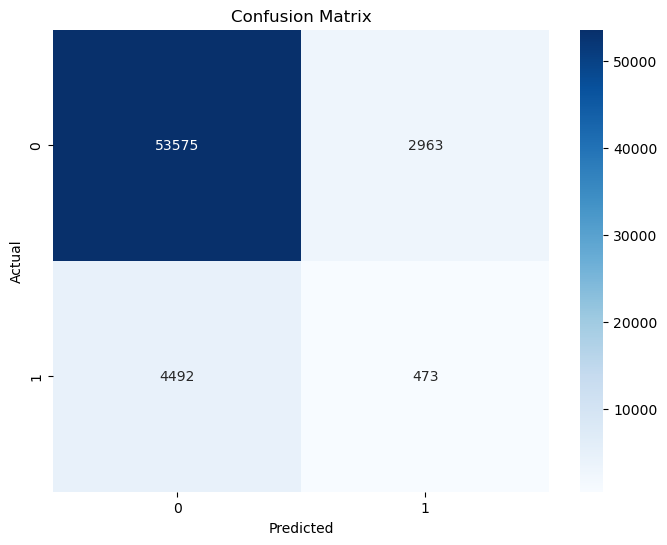

In [182]:
conf_matrix_r = confusion_matrix(y_test, y_pred_clf_r)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_r, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

## applying smote by diffrent percentage 

In [167]:
smote_after_p= SMOTE(random_state=42,sampling_strategy=0.40)
X_resampled_after_p, y_resampled_after_p = smote_after_p.fit_resample(X_train_scaled_R, y_train)

In [168]:
selector = SelectKBest(f_classif, k=10)
X_train_selected = selector.fit_transform(X_resampled_after_p, y_resampled_after_p)
X_test_selected = selector.transform(X_test_scaled_R)
selected_features_p = X.columns[selector.get_support()]
selected_features_p

Index(['DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
       'FLAG_EMP_PHONE', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'REG_CITY_NOT_WORK_CITY', 'FLAG_DOCUMENT_3', 'age'],
      dtype='object')

In [138]:
clf_random_p = RandomForestClassifier(n_estimators=100,random_state=42,class_weight='balanced')

In [139]:
clf_random_p.fit(X_train_selected,y_resampled_after_p)

RandomForestClassifier(class_weight='balanced', random_state=42)

In [140]:
y_pred_clf_p = clf_random_p.predict(X_test_selected)

In [141]:
accuracy_random_clf_p = accuracy_score(y_test, y_pred_clf_p)
accuracy_random_clf_p

0.8855015202510447

In [142]:
print("Random Forest Metrics:")
print("Accuracy:", accuracy_score(y_test, y_pred_clf_p))
print("Precision:", precision_score(y_test, y_pred_clf_p))
print("Recall:", recall_score(y_test, y_pred_clf_p))
print("F1 Score:", f1_score(y_test, y_pred_clf_p))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_clf_p))

Random Forest Metrics:
Accuracy: 0.8855015202510447
Precision: 0.13777467736309731
Recall: 0.07955689828801611
F1 Score: 0.10086823289070479
Confusion Matrix:
 [[54066  2472]
 [ 4570   395]]


In [146]:
report_clf_p = classification_report(y_test, y_pred_clf_p)

print("Classification Report:\n", report_clf_p)

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.96      0.94     56538
           1       0.14      0.08      0.10      4965

    accuracy                           0.89     61503
   macro avg       0.53      0.52      0.52     61503
weighted avg       0.86      0.89      0.87     61503



#### Class 0:
- **Precision:** 0.92
  - Out of all instances predicted as class 0, 92% were correctly predicted (true positives out of all predicted positives).
- **Recall:** 0.96
  - Of all actual instances of class 0, 96% were correctly identified (true positives out of all actual positives).
- **F1-Score:** 0.94
  - The harmonic mean of precision and recall, indicating a balance between the two metrics.
- **Support:** 56,538
  - The number of actual instances of class 0 in the dataset.

#### Class 1:
- **Precision:** 0.14
  - Of all instances predicted as class 1, only 14% were correctly predicted (true positives out of all predicted positives).
- **Recall:** 0.08
  - Of all actual instances of class 1, only 8% were correctly identified (true positives out of all actual positives).
- **F1-Score:** 0.10
  - The harmonic mean of precision and recall, reflecting how well the model predicts class 1.
- **Support:** 4,965
  - The number of actual instances of class 1 in the dataset.

#### Overall Metrics:
- **Accuracy:** 0.89
  - The overall percentage of correctly predicted instances (both classes) out of the total instances in the dataset.
- **Macro Avg:**
  - **Precision:** 0.53, **Recall:** 0.52, **F1-Score:** 0.52
  - The average precision, recall, and F1-score across both classes.
- **Weighted Avg:**
  - **Precision:** 0.86, **Recall:** 0.89, **F1-Score:** 0.87
  - The weighted average precision, recall, and F1-score, accounting for the imbalance in class support.


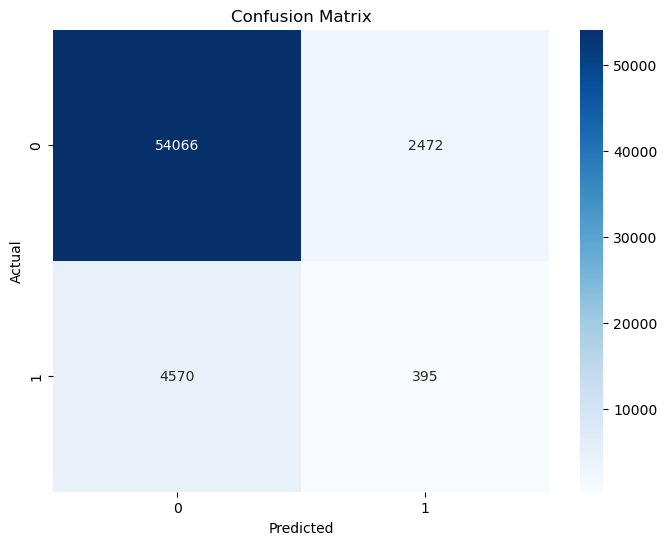

In [183]:
conf_matrix_s = confusion_matrix(y_test, y_pred_clf_p)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_s, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

## XGBOOST

In [169]:
clf_XG = xgb.XGBClassifier(scale_pos_weight=(len(y_train) - sum(y_train)) / sum(y_train), random_state=42)


In [170]:
clf_XG.fit(X_train_selected, y_resampled_after_p)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [171]:
y_pred_xg=clf_XG.predict(X_test_selected)

In [172]:
accuracy_random_clf_xg = accuracy_score(y_test, y_pred_xg)
accuracy_random_clf_xg

0.2550932474838626

In [173]:
print("Random Forest Metrics:")
print("Accuracy:", accuracy_score(y_test, y_pred_xg))
print("Precision:", precision_score(y_test, y_pred_xg))
print("Recall:", recall_score(y_test, y_pred_xg))
print("F1 Score:", f1_score(y_test, y_pred_xg))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_xg))

Random Forest Metrics:
Accuracy: 0.2550932474838626
Precision: 0.08784179194834023
Recall: 0.8767371601208459
F1 Score: 0.15968451944240647
Confusion Matrix:
 [[11336 45202]
 [  612  4353]]


In [184]:
report_clf_xg = classification_report(y_test, y_pred_xg)

print("Classification Report:\n", report_clf_xg)

Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.20      0.33     56538
           1       0.09      0.88      0.16      4965

    accuracy                           0.26     61503
   macro avg       0.52      0.54      0.25     61503
weighted avg       0.88      0.26      0.32     61503



#### Class 0:
- **Precision:** 0.95
  - Out of all instances predicted as class 0, 95% were correctly predicted (true positives out of all predicted positives).
- **Recall:** 0.20
  - Of all actual instances of class 0, only 20% were correctly identified (true positives out of all actual positives).
- **F1-Score:** 0.33
  - The harmonic mean of precision and recall, indicating a balance between the two metrics.
- **Support:** 56,538
  - The number of actual instances of class 0 in the dataset.

#### Class 1:
- **Precision:** 0.09
  - Of all instances predicted as class 1, only 9% were correctly predicted (true positives out of all predicted positives).
- **Recall:** 0.88
  - Of all actual instances of class 1, 88% were correctly identified (true positives out of all actual positives).
- **F1-Score:** 0.16
  - The harmonic mean of precision and recall, reflecting how well the model predicts class 1.
- **Support:** 4,965
  - The number of actual instances of class 1 in the dataset.

#### Overall Metrics:
- **Accuracy:** 0.26
  - The overall percentage of correctly predicted instances (both classes) out of the total instances in the dataset.
- **Macro Avg:**
  - **Precision:** 0.52, **Recall:** 0.54, **F1-Score:** 0.25
  - The average precision, recall, and F1-score across both classes.
- **Weighted Avg:**
  - **Precision:** 0.88, **Recall:** 0.26, **F1-Score:** 0.32
  - The weighted average precision, recall, and F1-score, accounting for the imbalance in class support.